# Qiskit Developer Certification 2021

## Operations on Quantum Circuits
### Quantum Circuit Construction and Measurement

In [1]:
# Imports
from qiskit import QuantumRegister, ClassicalRegister, QuantumCircuit
import numpy as np

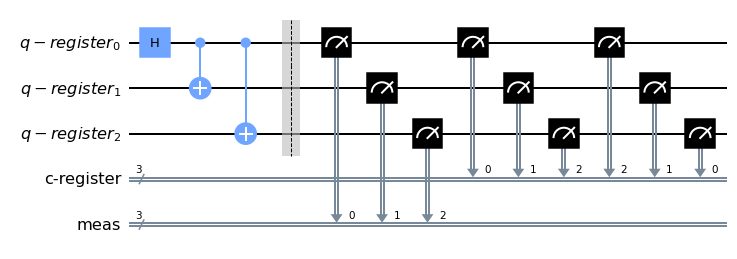

In [2]:
# Initializinf a quantum register of 3 qubits and name "q-register"
qr = QuantumRegister(size= 3 , name = "q-register")

# Exactly one of the size or bits arguments can be provided in the QuantumRegister class
# qr = QuantumRegister(size = None, name = "q-register", bits = [??])

# Classical Register with 3 bits and name "c-register"
cr = ClassicalRegister(size = 3, name = "c-register")

# Initializing a quantum circuit with name "q-circuit"
qc = QuantumCircuit(qr, cr, name = "q-circuit")

# Build Circuit
qc.h(0)
qc.cx(0, 1)
qc.cx(0, 2)

# Measurement
# Order of qubits vs classical bits --> qr[0, 1, 2] <-> cr[0, 1, 2]. Result display as --> [2, 1, 0]
# Surprisingly, this function uses a different set of classical register named "meas" (not the c-register)!
qc.measure_all()
# or
qc.measure(qr, cr)

# Change order of measurement. Result display as --> [0, 1, 2]
qc.measure([0, 1, 2], [2, 1, 0])

qc.draw('mpl')

### Quantum Circuit for reference - GHZ state circuit

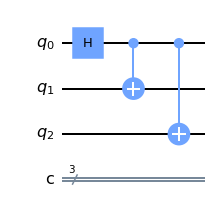

In [3]:
# Defnining a sample circuit (without measurements) for further reference.
# Circuit prepares state (000 + 111) called GHZ state!
q_ref = QuantumCircuit(3, 3)
q_ref.h(0)
q_ref.cx(0, 1)
q_ref.cx(0, 2)
q_ref.draw("mpl")

### Circuit extension

In [4]:
# # CAUTION: This circuit block adds measurements to q_ref itself!!!

# # Measure circuit (Reference circuit with measurements)
# meas = q_ref

# # Add a barrier before measurement.
# # NOTE: Barrier doesn't add to the depth of the circuit.
# meas.barrier([0, 1, 2])
# # or
# meas.barrier()

# # Measurement
# meas.measure([0, 1, 2], [2, 1, 0])

# meas.draw("mpl")
# q_ref.draw("mpl")

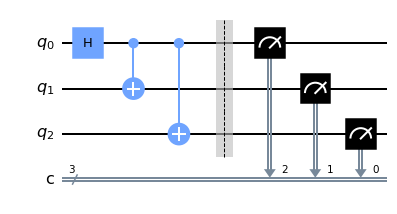

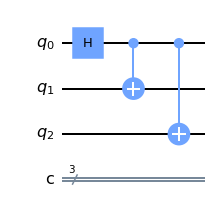

In [5]:
meas = QuantumCircuit(3, 3)
meas.barrier()
meas.measure([0, 1, 2], [2, 1, 0])

meas = meas.compose(q_ref, range(3), front = True)
display(meas.draw("mpl"))

display(q_ref.draw("mpl"))

### Circuit Visualization Transition

In [51]:
from qiskit.visualization import visualize_transition

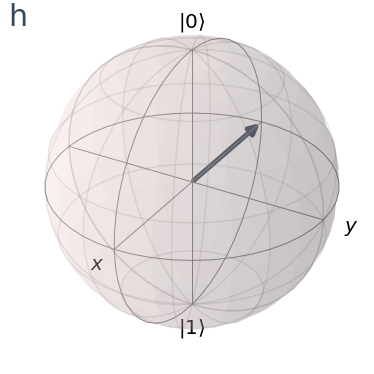

In [52]:
# Visualization works only with one qubit circuits!

# Building a one qubit circuit
q_one_qubit = QuantumCircuit(1)
q_one_qubit.x(0)
q_one_qubit.h(0)
# q_one_qubit.z(0)

visualize_transition(q_one_qubit)

### Circuit Simulation
Check details of the state that circuit pepares with this block.

In [6]:
# Import and use Statevector class
from qiskit.quantum_info import Statevector
from qiskit.visualization import array_to_latex

In [7]:
# Inintialize a state from initial state 0 to 2^3
state = Statevector.from_int(0, 2**3)

# Evolve the above state uing the reference circuit defined above
# NOTE: function doesn't work when circuit has measurements!
state = state.evolve(q_ref)

# Use latex to display array
display(state.draw("latex"))
# or
display(array_to_latex(state))

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

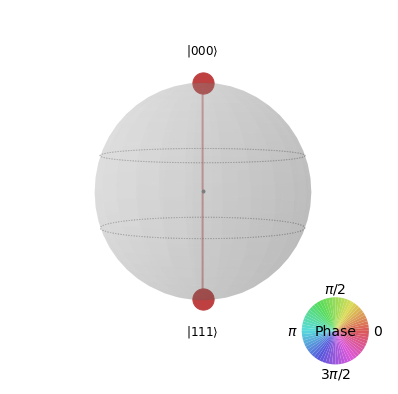

In [8]:
# Draw qsphere of the evolved state
state.draw("qsphere")

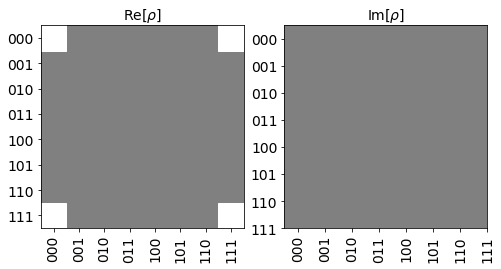

In [9]:
# Draw hinton of the state evolved
# Hinton displays both real and imaginary parts of the state
state.draw("hinton")

### Qiskit Simulators and Result Visualization

In [10]:
# Imports for visualization
from qiskit.visualization import plot_histogram, plot_bloch_vector, plot_bloch_multivector, plot_state_qsphere, plot_state_city, plot_state_hinton, plot_state_paulivec

'''For Plotting States
plot_state_city(quantum_state)
plot_state_qsphere(quantum_state)
plot_state_paulivec(quantum_state)
plot_state_hinton(quantum_state)
plot_bloch_multivector(quantum_state)
'''

'For Plotting States\nplot_state_city(quantum_state)\nplot_state_qsphere(quantum_state)\nplot_state_paulivec(quantum_state)\nplot_state_hinton(quantum_state)\nplot_bloch_multivector(quantum_state)\n'

In [11]:
# Importing Aer component of Qiskit
# NOTE: We generally use 3 main simualtors from Aer: 1) "qasm_simulator", 2) "statevector_simulator, 3) "unitary_simulator"
from qiskit import Aer, IBMQ, BasicAer
from qiskit import execute

provider = IBMQ.load_account()

display(Aer.backends())
print("\n")
display(BasicAer.backends())

[AerSimulator('aer_simulator'),
 AerSimulator('aer_simulator_statevector'),
 AerSimulator('aer_simulator_density_matrix'),
 AerSimulator('aer_simulator_stabilizer'),
 AerSimulator('aer_simulator_matrix_product_state'),
 AerSimulator('aer_simulator_extended_stabilizer'),
 AerSimulator('aer_simulator_unitary'),
 AerSimulator('aer_simulator_superop'),
 QasmSimulator('qasm_simulator'),
 StatevectorSimulator('statevector_simulator'),
 UnitarySimulator('unitary_simulator'),
 PulseSimulator('pulse_simulator')]

[<QasmSimulatorPy('qasm_simulator')>,
 <StatevectorSimulatorPy('statevector_simulator')>,
 <UnitarySimulatorPy('unitary_simulator')>]

In [12]:
# Access all 3 backends
backend1 = Aer.get_backend("qasm_simulator")
backend2 = Aer.get_backend("statevector_simulator")
backend3 = Aer.get_backend("unitary_simulator")

# Access real backend using provider (instead of Aer)
backend4 = provider.get_backend("ibmq_belem")

#### Backend -1 (Qasm Simualtor)

In [13]:
# Getting results with Backend-1
# "qasm_simulator" gives results with a measurement circuit (meas)

# Execute a job on backend1
job1 = execute(experiments = meas, backend = backend1, shots = 1024)
# or
# job = execute(experiments = meas, backend = backend1, basis_gates = ["cx", "u1", "u2", "u3"], coupling_map = map, shots = 1024)

# Retrieve results
result1 = job1.result()

# get counts of the number of times a state appears as a result
counts1 = result1.get_counts()

print("Resuts-1: ", result1, "\n\n")
print("Counts-1: ", counts1)

Resuts-1:  Result(backend_name='qasm_simulator', backend_version='0.8.2', qobj_id='4a00cfc0-ee00-42ab-bbbc-769cb7dbcd75', job_id='a990bf53-ce44-4737-9c0a-64aa2c6adfff', success=True, results=[ExperimentResult(shots=1024, success=True, meas_level=MeasLevel.CLASSIFIED, data=ExperimentResultData(counts={'0x0': 513, '0x7': 511}), header=QobjExperimentHeader(clbit_labels=[['c', 0], ['c', 1], ['c', 2]], creg_sizes=[['c', 3]], global_phase=0.0, memory_slots=3, metadata=None, n_qubits=3, name='circuit-2', qreg_sizes=[['q', 3]], qubit_labels=[['q', 0], ['q', 1], ['q', 2]]), status=DONE, seed_simulator=250115044, metadata={'parallel_shots': 1, 'method': 'stabilizer', 'parallel_state_update': 4, 'measure_sampling': True, 'fusion': {'enabled': False}}, time_taken=0.003768958)], date=2021-07-28T12:20:49.564827, status=COMPLETED, status=QobjHeader(backend_name='qasm_simulator', backend_version='0.8.2'), metadata={'time_taken': 0.00392081, 'parallel_experiments': 1, 'omp_enabled': True, 'max_gpu_memo

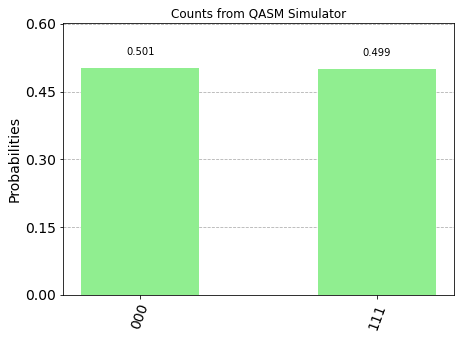

In [14]:
plot_histogram(counts1, title = "Counts from QASM Simulator", color = ["lightgreen"])

In [15]:
# Execute a second job on backend1
job12 = execute(experiments = meas, backend = backend1, shots = 1024)
# or
# job = execute(experiments = meas, backend = backend1, basis_gates = ["cx", "u1", "u2", "u3"], coupling_map = map, shots = 1024)

# Retrieve results
result12 = job12.result()

# get counts of the number of times a state appears as a result
counts12 = result12.get_counts()

print("Resuts-12: ", result12, "\n\n")
print("Counts-12: ", counts12)

Resuts-12:  Result(backend_name='qasm_simulator', backend_version='0.8.2', qobj_id='3c9ac65c-43ef-47cd-be7e-c5a47f9b9a47', job_id='ee3f4c84-b532-4352-abfe-932b1ebebbae', success=True, results=[ExperimentResult(shots=1024, success=True, meas_level=MeasLevel.CLASSIFIED, data=ExperimentResultData(counts={'0x0': 525, '0x7': 499}), header=QobjExperimentHeader(clbit_labels=[['c', 0], ['c', 1], ['c', 2]], creg_sizes=[['c', 3]], global_phase=0.0, memory_slots=3, metadata=None, n_qubits=3, name='circuit-2', qreg_sizes=[['q', 3]], qubit_labels=[['q', 0], ['q', 1], ['q', 2]]), status=DONE, seed_simulator=33697800, metadata={'parallel_shots': 1, 'method': 'stabilizer', 'parallel_state_update': 4, 'measure_sampling': True, 'fusion': {'enabled': False}}, time_taken=0.004071676000000001)], date=2021-07-28T12:20:49.848014, status=COMPLETED, status=QobjHeader(backend_name='qasm_simulator', backend_version='0.8.2'), metadata={'time_taken': 0.004325164, 'parallel_experiments': 1, 'omp_enabled': True, 'ma

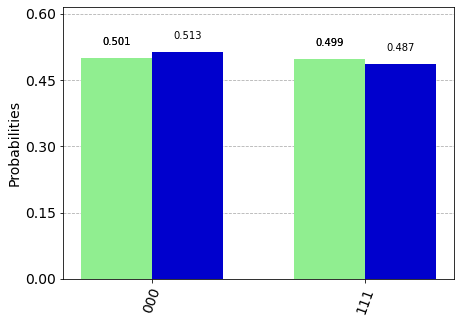

In [16]:
# Compare results from the 2 jobs executed
plot_histogram([counts1, counts12], color = ["lightgreen", "mediumblue"])

#### Backend-2 (Statevector Simulator)

In [17]:
# Getting results with Backend-2
# "statevector_simulator" gives results with a no-measurement circuit (q_ref)

job2 = execute(experiments = q_ref, backend = backend2, shots = 1024)
result2 = job2.result()

# Get final statevector output of the circuit
statevector2 = result2.get_statevector()

print("Resuts-2: ", result2, "\n\n")
print("Statevector-2: ", statevector2)

Resuts-2:  Result(backend_name='statevector_simulator', backend_version='0.8.2', qobj_id='208fa84d-2904-47f5-a419-e0ad91d8f604', job_id='5ca9ec86-7624-4e3e-9dd8-3992ba0080c8', success=True, results=[ExperimentResult(shots=1024, success=True, meas_level=MeasLevel.CLASSIFIED, data=ExperimentResultData(counts={'0x0': 1}, statevector=[0.70710678+0.j 0.        +0.j 0.        +0.j 0.        +0.j
 0.        +0.j 0.        +0.j 0.        +0.j 0.70710678+0.j]), header=QobjExperimentHeader(clbit_labels=[['c', 0], ['c', 1], ['c', 2]], creg_sizes=[['c', 3]], global_phase=0.0, memory_slots=3, metadata=None, n_qubits=3, name='circuit-1', qreg_sizes=[['q', 3]], qubit_labels=[['q', 0], ['q', 1], ['q', 2]]), status=DONE, seed_simulator=1532570269, metadata={'parallel_state_update': 4, 'parallel_shots': 1}, time_taken=0.00010417500000000001)], date=2021-07-28T12:20:50.014897, status=COMPLETED, status=QobjHeader(backend_name='statevector_simulator', backend_version='0.8.2'), metadata={'time_taken': 0.000

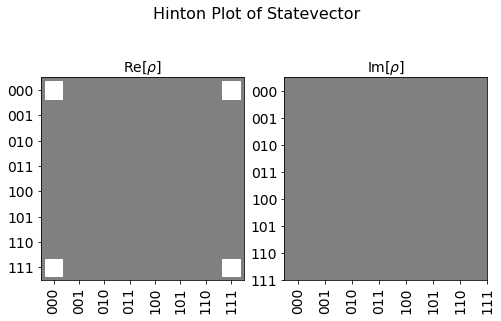

In [18]:
# PLot hinton
plot_state_hinton(statevector2, title = "Hinton Plot of Statevector") # no color argument

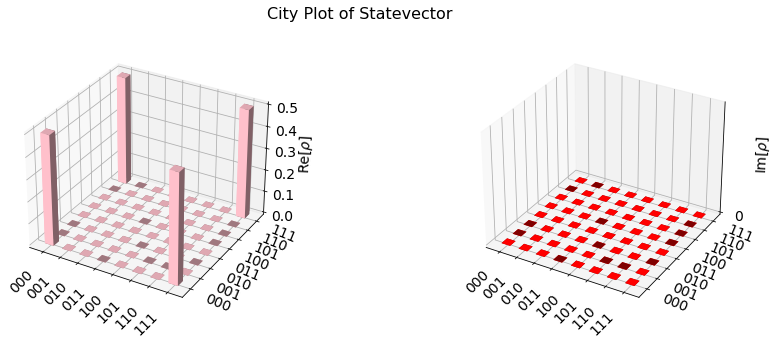

In [19]:
# Plot State City with both real and imaginary parts
plot_state_city(statevector2, title = "City Plot of Statevector", color = ["pink", "red"])

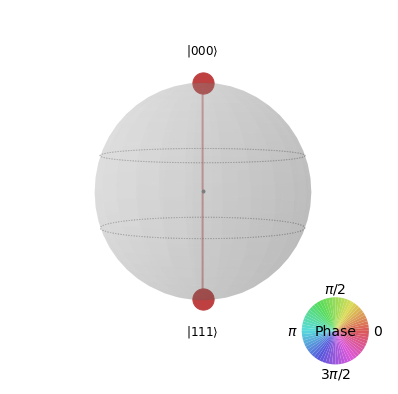

In [20]:
# Plot qsphere
display(plot_state_qsphere(statevector2)) # no title argument

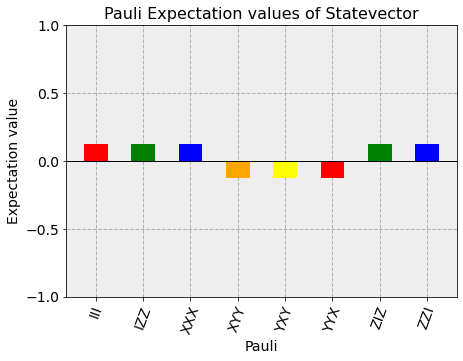

In [21]:
# Plot Pauli Expectation values
plot_state_paulivec(statevector2, title = "Pauli Expectation values of Statevector", color = ["red", "green", "blue", "orange", "yellow"])

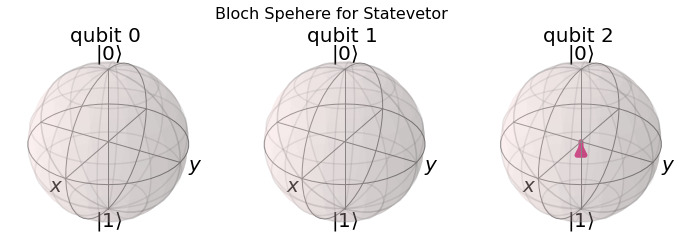

In [22]:
# Bloch Sphere
plot_bloch_multivector(statevector2, title = "Bloch Spehere for Statevetor") 

# can also mention figsize argument as a tuple(width, height) in almost all visualization methods!

#### Backend-3 (Unitary Simulator)

In [23]:
# Getting results with Backend-2
# "statevector_simulator" gives results with a no-measurement circuit (q_ref)

job3 = execute(experiments = q_ref, backend = backend3, shots = 1024)
result3 = job3.result()

# Get final unitary output of the circuit and round to 3 decimals
unitary3 = result3.get_unitary(decimals = 3)

print("Resuts-3: ", result3, "\n\n")
print("Unitary-3: ", unitary3)

display(array_to_latex(unitary3))

Resuts-3:  Result(backend_name='unitary_simulator', backend_version='0.8.2', qobj_id='9b03ac06-d5ab-43f0-8d2e-974dd9fa71cd', job_id='781650a0-3085-4d22-ac82-9e25d35fcebc', success=True, results=[ExperimentResult(shots=1024, success=True, meas_level=MeasLevel.CLASSIFIED, data=ExperimentResultData(counts={'0x0': 1}, unitary=[[ 0.70710678+0.00000000e+00j  0.70710678-8.65956056e-17j
   0.        +0.00000000e+00j  0.        +0.00000000e+00j
   0.        +0.00000000e+00j  0.        +0.00000000e+00j
   0.        +0.00000000e+00j  0.        +0.00000000e+00j]
 [ 0.        +0.00000000e+00j  0.        +0.00000000e+00j
   0.        +0.00000000e+00j  0.        +0.00000000e+00j
   0.        +0.00000000e+00j  0.        +0.00000000e+00j
   0.70710678+0.00000000e+00j -0.70710678+8.65956056e-17j]
 [ 0.        +0.00000000e+00j  0.        +0.00000000e+00j
   0.70710678+0.00000000e+00j  0.70710678-8.65956056e-17j
   0.        +0.00000000e+00j  0.        +0.00000000e+00j
   0.        +0.00000000e+00j  0.   

<IPython.core.display.Latex object>

#### Backend-4 (Real Backend)

In [24]:
from qiskit.tools import job_monitor

In [25]:
'''
# Getting results with Backend-1
# Real device (ibmq_belem) gives results with a measurement circuit (meas)

job4 = execute(experiments = meas, backend = backend4, shots = 1024)

# Monitor the job using job_monitor tool
job_monitor(job4)
'''

'\n# Getting results with Backend-1\n# Real device (ibmq_belem) gives results with a measurement circuit (meas)\n\njob4 = execute(experiments = meas, backend = backend4, shots = 1024)\n\n# Monitor the job using job_monitor tool\njob_monitor(job4)\n'

In [26]:
'''
result4 = job4.result()
counts4 = result4.get_counts()

print("Resuts-4: ", result4, "\n\n")
print("Counts-4: ", counts4)
'''

'\nresult4 = job4.result()\ncounts4 = result4.get_counts()\n\nprint("Resuts-4: ", result4, "\n\n")\nprint("Counts-4: ", counts4)\n'

In [27]:
'''
plot_histogram(counts4, color = ["pink"])
'''

'\nplot_histogram(counts4, color = ["pink"])\n'

### Operators

In [28]:
# Imports
from qiskit.quantum_info import Operator

In [29]:
# Changing circuit to unitary is a whole lot similar to the code block of "unitary_simualtor"!

# Change q_ref circuit to an Operator (Matrix operator that is reversible!) using Operator function
U = Operator(q_ref)

# Prints the state of the circuit
display(U.data)

display(array_to_latex(U.data))

# Round to 3 decimal places
display(np.around(U.data, 3))

array([[ 0.70710678+0.j,  0.70710678+0.j,  0.        +0.j,
         0.        +0.j,  0.        +0.j,  0.        +0.j,
         0.        +0.j,  0.        +0.j],
       [ 0.        +0.j,  0.        +0.j,  0.        +0.j,
         0.        +0.j,  0.        +0.j,  0.        +0.j,
         0.70710678+0.j, -0.70710678+0.j],
       [ 0.        +0.j,  0.        +0.j,  0.70710678+0.j,
         0.70710678+0.j,  0.        +0.j,  0.        +0.j,
         0.        +0.j,  0.        +0.j],
       [ 0.        +0.j,  0.        +0.j,  0.        +0.j,
         0.        +0.j,  0.70710678+0.j, -0.70710678+0.j,
         0.        +0.j,  0.        +0.j],
       [ 0.        +0.j,  0.        +0.j,  0.        +0.j,
         0.        +0.j,  0.70710678+0.j,  0.70710678+0.j,
         0.        +0.j,  0.        +0.j],
       [ 0.        +0.j,  0.        +0.j,  0.70710678+0.j,
        -0.70710678+0.j,  0.        +0.j,  0.        +0.j,
         0.        +0.j,  0.        +0.j],
       [ 0.        +0.j,  0.      

<IPython.core.display.Latex object>

array([[ 0.707+0.j,  0.707+0.j,  0.   +0.j,  0.   +0.j,  0.   +0.j,
         0.   +0.j,  0.   +0.j,  0.   +0.j],
       [ 0.   +0.j,  0.   +0.j,  0.   +0.j,  0.   +0.j,  0.   +0.j,
         0.   +0.j,  0.707+0.j, -0.707+0.j],
       [ 0.   +0.j,  0.   +0.j,  0.707+0.j,  0.707+0.j,  0.   +0.j,
         0.   +0.j,  0.   +0.j,  0.   +0.j],
       [ 0.   +0.j,  0.   +0.j,  0.   +0.j,  0.   +0.j,  0.707+0.j,
        -0.707+0.j,  0.   +0.j,  0.   +0.j],
       [ 0.   +0.j,  0.   +0.j,  0.   +0.j,  0.   +0.j,  0.707+0.j,
         0.707+0.j,  0.   +0.j,  0.   +0.j],
       [ 0.   +0.j,  0.   +0.j,  0.707+0.j, -0.707+0.j,  0.   +0.j,
         0.   +0.j,  0.   +0.j,  0.   +0.j],
       [ 0.   +0.j,  0.   +0.j,  0.   +0.j,  0.   +0.j,  0.   +0.j,
         0.   +0.j,  0.707+0.j,  0.707+0.j],
       [ 0.707+0.j, -0.707+0.j,  0.   +0.j,  0.   +0.j,  0.   +0.j,
         0.   +0.j,  0.   +0.j,  0.   +0.j]])

## Initializing with a desired state

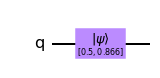

In [30]:
# Define desired state as an array/vector
# NOTE: Sum of amplitude-sqaured should be = 1
alpha = 1/np.sqrt(4)
v = [alpha, np.sqrt(1 - (alpha**2))]

qc_n = QuantumCircuit(1)
qc_n.initialize(v, 0)
# qc_n.measure_all()

qc_n.draw("mpl")

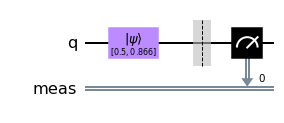

In [31]:
qc_meas = QuantumCircuit(1)
qc_meas.measure_all()

qc_meas = qc_meas.compose(qc_n, range(1), front = True)
qc_meas.draw("mpl")

In [32]:
# Verifying the results!

# Expected Results:
alpha_squared = v[0]**2
beta_squared = v[1]**2
print(alpha_squared, beta_squared)

0.25 0.7499999999999999


In [33]:
# Trying on simualtor
job_n = execute(qc_meas, backend = backend1, shots = 1024)
result_n = job_n.result()
counts_n = result_n.get_counts()

# Probabilities are similar to the alpha/beta-squared values!!
print(counts_n)

{'0': 260, '1': 764}


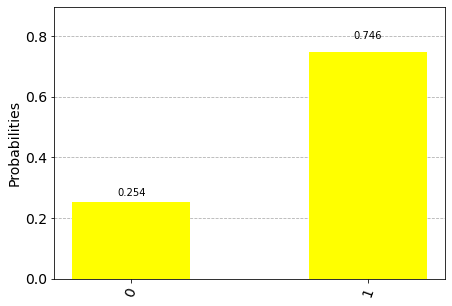

In [34]:
plot_histogram(counts_n, color = ["yellow"])

### Decompose

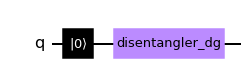

In [35]:
# Dcommpose the circuit initialized to desired state. 
# NOTE: This circuit containes an initializer with value ket-0
qc_decompose = qc_n.decompose()

qc_decompose.draw("mpl")

### Measure Fidelity
#### State Fidelity

In [36]:
from qiskit.quantum_info import state_fidelity

In [37]:
# State fidelity is the similarity of the initialized state vs the state produced by running the circuit on the simulator.
# So first execute the circuit on "statevector_simulator"

job_s = execute(qc_n, backend2, shots = 1024)
result_s = job_s.result()
statevector_s = result_s.get_statevector()

print(statevector_s)
display(array_to_latex(statevector_s))

[0.5      +0.j 0.8660254+0.j]


<IPython.core.display.Latex object>

In [38]:
# Measure state fidelity of desired state (v) and statevector_s using state_fidelity
state_fidelity(v, statevector_s)

0.9999999999999998

#### Fidelity of Gates and Processes

In [39]:
from qiskit.quantum_info import process_fidelity, average_gate_fidelity, Operator
from qiskit.circuit.library import XGate

In [40]:
# Change XGate to an operator
operator1 = Operator(XGate())

# Tak esecond operator with just a phase difference
operator2 = np.exp(1j/2)*operator1

In [41]:
# Gate fidelity is the fidelity of the ...
average_gate_fidelity(operator1, operator2)

1.0

In [42]:
# Process fidelity is the fidelity of the ...
process_fidelity(operator1, operator2)

1.0

### Circuit Depth

In [43]:
# Printing the depth of a circuit
q_ref.depth()

3

In [44]:
# Depth also includes the measurement gates!!
meas.depth()

4

### Backend Features

In [45]:
import qiskit.tools.jupyter
from qiskit.visualization import plot_gate_map, plot_error_map, plot_circuit_layout

In [46]:
%qiskit_backend_overview

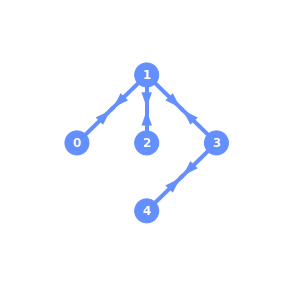

In [47]:
# ibmq_belem
# directed means that the direction of connection is displayed.
plot_gate_map(backend4, plot_directed = True)

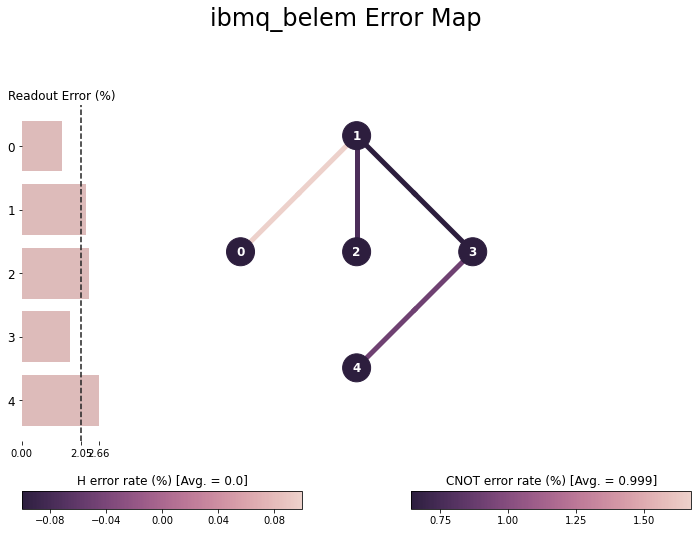

In [48]:
plot_error_map(backend4, show_title = True)

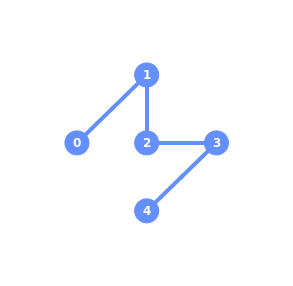

In [49]:
# ibmq_santiago
backend5 = provider.get_backend("ibmq_santiago")
plot_gate_map(backend5)

In [53]:
from qiskit.compiler import transpile

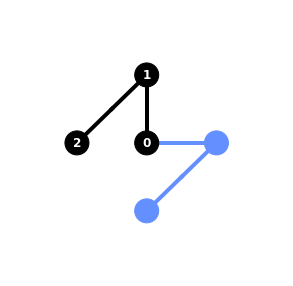

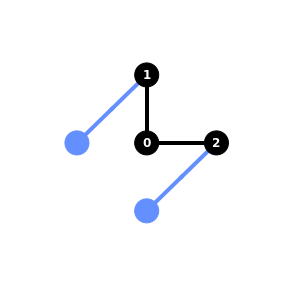

In [54]:
# Circuit layout of the q_ref circuit on the "ibmq_santiago" real backend
q_ref_transpile = transpile(q_ref, backend = backend5)
display(plot_circuit_layout(q_ref_transpile, backend5))

# or
q_ref_transpile_2 = transpile(q_ref, backend = backend5, optimization_level = 3)
display(plot_circuit_layout(q_ref_transpile_2, backend5))

### QASM

In [55]:
# Change from circuit to QASM code.
qasm_str = q_ref.qasm()

print(qasm_str)

OPENQASM 2.0;
include "qelib1.inc";
qreg q[3];
creg c[3];
h q[0];
cx q[0],q[1];
cx q[0],q[2];



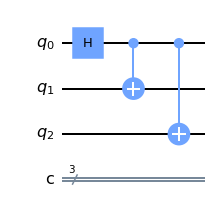

In [56]:
# Change from QASM code to circuit
q_qasm_ref = QuantumCircuit.from_qasm_str(qasm_str)
q_qasm_ref.draw("mpl")

### Circuit decomposition

In [57]:
from qiskit.compiler import transpile
from qiskit.visualization import circuit_drawer

In [58]:
q_transpile = transpile(q_ref, basis_gates = ["u3", "cx", "s"])

circuit_drawer(q_transpile, output = "text")

┌─────────────┐          
q_0: ┤ U3(π/2,0,π) ├──■────■──
     └─────────────┘┌─┴─┐  │  
q_1: ───────────────┤ X ├──┼──
                    └───┘┌─┴─┐
q_2: ────────────────────┤ X ├
                         └───┘
c: 3/═════════════════════════

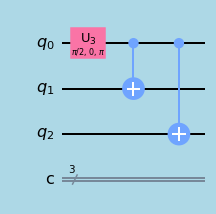

In [59]:
q_transpile.draw("mpl", style = {"backgroundcolor": "lightblue"})

### Custom Controlled Gates

### Circuits to Gates